###Lecture3_Exercises

**Economics dataset analysis**

The folder economics (~/DSE200/DSE200/data/economics/) has a set of small datasets corresponding to different economics topics. We will use Pandas to incorporate these datasets into our workflow, merge them and analyze the economic trends as a function of time.

To achieve this, do the following

1. Read each of the csv files iteratively "control-shift-minus"

2. Merge all of the data into a single dataframe by building a dictionary where the keys are the codes and the values are the Series from each downloaded file
3. Construct the Term and Default premia series using basic math on the series, and mmerge the resulting series using JOIN operation. HINT: term_premium = merged_data[’GS10’] - merged_data[’GS1’] and default_premium = merged_data[’BAA’] - merged_data[’AAA’]
4. Process the data
5. Plot ’GDP_growth’,’IP_growth’ and 'Unemp_rate' a a function of time and draw inferences
6. Use pandas function scatter_matrix to generate scatter plots of ’GDP_growth’,’IP_growth’ and 'Unemp_rate' in a mmatrix form with kernel density plots along the diagonals.

Note: Processing the data is of utmost importance for better readability and understanding of the data. Process the above data by ensuring the following

1. dropping the rows with null values
2. Output data regularly to see if they are following regular format. Use pandas.series.pct_change wherever necessary

**The codes and their corresponding series representation**

                            Series                   Code           Frequency
                            Real GDP                 GDPC1          Quarterly
                            Industrial Production   INDPRO          Quarterly
                            Core CPI               CPILFESL         Monthly
                            Unemployment Rate       UNRATE          Monthly
                            10 Year Yield            GS10           Monthly
                            1 Year Yield             GS1            Monthly
                            Baa Yield                BAA            Monthly
                            Aaa Yield                AAA            Monthly
                            
** Variable Description **

                            Series                        Description
                            Treated                       Dummy indicating whether the candidate received the treatment
                            Age                           Age in years
                            Education (years)             Years of Education
                            Black                         Dummy indicating African-American
                            Hispanic                      Dummy indicating Hispanic
                            Married                       Dummy indicating married
                            Real income Before ($)        Income before program
                        Real income After ($)         Income after program           

In [10]:
%pylab inline
import pandas as pd
import numpy as np
import sklearn as sk
#mpl_toolkits.basemap import Basemap
# use the dates as indexes, values as the columns

Populating the interactive namespace from numpy and matplotlib


`%matplotlib` prevents importing * from pylab and numpy


In [2]:
%cd /Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/day_3_models_and_learning
%cd ../data/economics/

/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/day_3_models_and_learning
/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/economics


In [3]:
!ls

AAA.csv      CPILFESL.csv GS1.csv      INDPRO.csv
BAA.csv      GDPC1.csv    GS10.csv     UNRATE.csv


In [4]:
!head -5 AAA.csv

2. Merge all of the data into a single dataframe by building a dictionary where the keys are the codes and the values are the Series from each downloaded file

In [11]:
#AAA = pd.read_csv('AAA.csv', error_bad_lines=False)
import os
import csv
path = "/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/economics"
%cd $path
d= dict()
for fn in os.listdir('.'):
    if (os.path.isfile(fn) and fn[-4:] == '.csv'):
        l= dict()
        with open(fn, 'rb') as f:
            reader = csv.reader(f)
            next(reader, None) # this skips the headers
            for i in reader:
                l[i[0]] = float(i[1])
        d[fn.replace('.csv', '' )]= l
        

/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/economics


In [12]:
merged= pd.DataFrame.from_dict(d)
merged

,AAA,BAA,CPILFESL,GDPC1,GS1,GS10,INDPRO,UNRATE
1919-01-01,5.35,7.12,NaN,NaN,NaN,NaN,4.8582,NaN
1919-02-01,5.35,7.20,NaN,NaN,NaN,NaN,4.6435,NaN
1919-03-01,5.39,7.15,NaN,NaN,NaN,NaN,4.5092,NaN
1919-04-01,5.44,7.23,NaN,NaN,NaN,NaN,4.5898,NaN
1919-05-01,5.39,7.09,NaN,NaN,NaN,NaN,4.6166,NaN
1919-06-01,5.40,7.04,NaN,NaN,NaN,NaN,4.9119,NaN
1919-07-01,5.44,7.06,NaN,NaN,NaN,NaN,5.2071,NaN
1919-08-01,5.56,7.13,NaN,NaN,NaN,NaN,5.2876,NaN
1919-09-01,5.60,7.27,NaN,NaN,NaN,NaN,5.1803,NaN
1919-10-01,5.54,7.34,NaN,NaN,NaN,NaN,5.1266,NaN


3. Construct the Term and Default premia series using basic math on the series, and mmerge the resulting series using JOIN operation. HINT: term_premium = merged_data[’GS10’] - merged_data[’GS1’] and default_premium = merged_data[’BAA’] - merged_data[’AAA’]
4. Process the data

In [13]:
merged['term_premium'] = merged['GS10']-merged['GS1']
merged['default_premium'] = merged['BAA'] - merged['AAA']
#.map(lambda x: 42 if x > 1 else 55)
#use set index date if necessary
merged.head()


,AAA,BAA,CPILFESL,GDPC1,GS1,GS10,INDPRO,UNRATE,term_premium,default_premium
1919-01-01,5.35,7.12,NaN,NaN,NaN,NaN,4.8582,NaN,NaN,1.77
1919-02-01,5.35,7.20,NaN,NaN,NaN,NaN,4.6435,NaN,NaN,1.85
1919-03-01,5.39,7.15,NaN,NaN,NaN,NaN,4.5092,NaN,NaN,1.76
1919-04-01,5.44,7.23,NaN,NaN,NaN,NaN,4.5898,NaN,NaN,1.79
1919-05-01,5.39,7.09,NaN,NaN,NaN,NaN,4.6166,NaN,NaN,1.70


2. Process the data by dropping nulls and using percetn change to fill in the gaps 

In [15]:
merged=merged.dropna()
merged.head()

,AAA,BAA,CPILFESL,GDPC1,GS1,GS10,INDPRO,UNRATE,term_premium,default_premium
1957-01-01,3.77,4.49,28.5,2854.5,3.37,3.46,21.9289,4.2,0.09,0.72
1957-04-01,3.67,4.44,28.8,2848.2,3.49,3.48,21.8215,3.9,-0.01,0.77
1957-07-01,3.99,4.73,29.0,2875.9,3.81,3.93,21.9289,4.2,0.12,0.74
1957-10-01,4.10,4.99,29.2,2846.4,4.01,3.97,21.4189,4.5,-0.04,0.89
1958-01-01,3.60,4.83,29.3,2772.7,2.65,3.09,20.1306,5.8,0.44,1.23


In [17]:
df_percentchange= merged.pct_change()
df_percentchange.head()


,AAA,BAA,CPILFESL,GDPC1,GS1,GS10,INDPRO,UNRATE,term_premium,default_premium
1957-01-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1957-04-01,-0.026525,-0.011136,0.010526,-0.002207,0.035608,0.005780,-0.004898,-0.071429,-1.111111,0.069444
1957-07-01,0.087193,0.065315,0.006944,0.009725,0.091691,0.129310,0.004922,0.076923,-13.000000,-0.038961
1957-10-01,0.027569,0.054968,0.006897,-0.010258,0.052493,0.010178,-0.023257,0.071429,-1.333333,0.202703
1958-01-01,-0.121951,-0.032064,0.003425,-0.025892,-0.339152,-0.221662,-0.060148,0.288889,-12.000000,0.382022


4. Plot ’GDP_growth’,’IP_growth’ and 'Unemp_rate' a a function of time and draw inferences


Answer/Inference: In the diagrams below we see a strong inverse correlation between unemployment rate and GDP, and similiarly with unemployement rate and IP-growth.  Some of the highest unemployement rates were around 1957, 1974, and 2007. 

Industrial production seams to be more variable over time and sees large spikes that are many times stronger than regualr GDP.  

               GDPC1    INDPRO  Unemployment Rate
1957-01-01       NaN       NaN                4.2
1957-04-01 -0.002207 -0.004898                3.9
1957-07-01  0.007518  0.000024                4.2
1957-10-01 -0.002739 -0.023233                4.5
1958-01-01 -0.028632 -0.083381                5.8


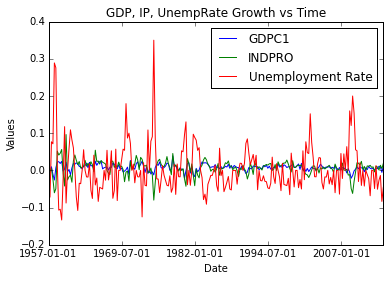

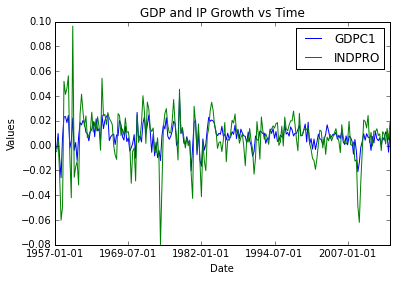

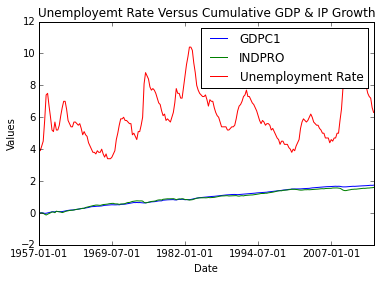

In [58]:
zoom_on_GDP=merged.iloc[:, [3,6]].pct_change()
zoom_on_GDP["Unemployment Rate"]=merged.iloc[:,[7]].pct_change()
plt.figure(); zoom_on_GDP.plot(); plt.legend(loc='best')
plt.title('GDP, IP, UnempRate Growth vs Time')
plt.xlabel('Date')
plt.ylabel('Values')

GDP_vs_IP=merged.iloc[:, [3,6]].pct_change()
plt.figure(); GDP_vs_IP.plot(); plt.legend(loc='best')
plt.title('GDP and IP Growth vs Time')
plt.xlabel('Date')
plt.ylabel('Values')

growth=merged.iloc[:, [3,6]].pct_change().cumsum()
growth["Unemployment Rate"]=merged.iloc[:,[7]]
#iloc[3, 6, 7]
#"GDPC1", "INDPRO",'UNRATE'
#df.loc[row_indexer,column_indexer]
print growth.head()
plt.figure(); growth.plot(); plt.legend(loc='best')
plt.title('Unemployemt Rate Versus Cumulative GDP & IP Growth')
plt.xlabel('Date')
plt.ylabel('Values')

5) Use pandas function scatter_matrix to generate scatter plots of ’GDP_growth’,’IP_growth’ and 'Unemp_rate' in a mmatrix form with kernel density plots along the diagonals.

Answer - This graph shows the correlations above and proves that as as GDP and Industrial production experience a negative change in production, the unemployement rate follows and goes up. 

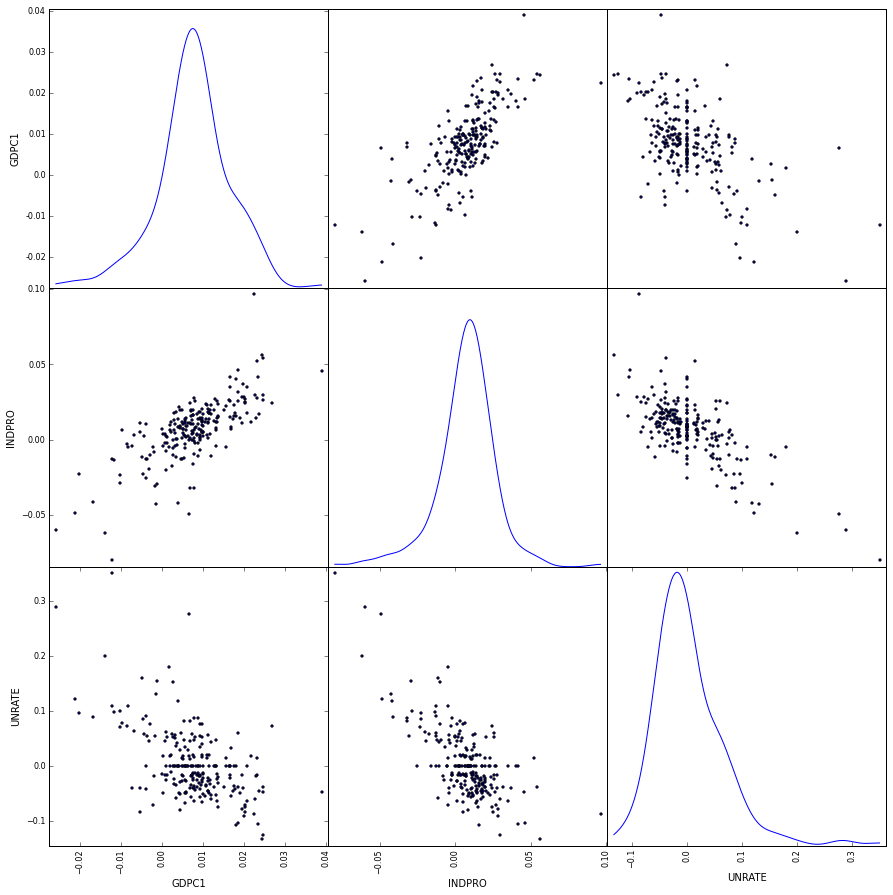

In [80]:
from pandas.tools.plotting import scatter_matrix
df = merged.iloc[:,[3,6,7]].pct_change()
scatter_matrix(df, alpha=1, figsize=(15, 15), diagonal='kde');

6. Use pandas function scatter_matrix to generate scatter plots of ’GDP_growth’,’IP_growth’ and 'Unemp_rate' in a mmatrix form with kernel density plots along the diagonals.

In [11]:
from pandas.tools.plotting import scatter_matrix

**Nutrition dataset analysis**

Download the dataset from http://ashleyw.co.uk/files/foods-2011-10-03.json.zip
This data set is a compilation of data provided by the US department of Agriculture. The data set contains data for 6,636 unique foods and 94 unique nutrients (with an average of 56.5 nutrients per food)

Do the following

Use the built in python json module to load the food data into a python list

Your code should look like this

> import json
> db = json.load(open('foods-2011-10-03.json'))

In [12]:
!curl https://raw.githubusercontent.com/pydata/pydata-book/master/ch07/foods-2011-10-03.json > foods

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 30.3M  100 30.3M    0     0  1771k      0  0:00:17  0:00:17 --:--:-- 2143k


In [13]:
import json
db = json.load(open('foods'))

In [17]:
print db

[{u'portions': [{u'amount': 1, u'grams': 28.35, u'unit': u'oz'}], u'description': u'Cheese, caraway', u'tags': [], u'nutrients': [{u'units': u'g', u'group': u'Composition', u'description': u'Protein', u'value': 25.18}, {u'units': u'g', u'group': u'Composition', u'description': u'Total lipid (fat)', u'value': 29.2}, {u'units': u'g', u'group': u'Composition', u'description': u'Carbohydrate, by difference', u'value': 3.06}, {u'units': u'g', u'group': u'Other', u'description': u'Ash', u'value': 3.28}, {u'units': u'kcal', u'group': u'Energy', u'description': u'Energy', u'value': 376.0}, {u'units': u'g', u'group': u'Composition', u'description': u'Water', u'value': 39.28}, {u'units': u'kJ', u'group': u'Energy', u'description': u'Energy', u'value': 1573.0}, {u'units': u'g', u'group': u'Composition', u'description': u'Fiber, total dietary', u'value': 0.0}, {u'units': u'mg', u'group': u'Elements', u'description': u'Calcium, Ca', u'value': 673.0}, {u'units': u'mg', u'group': u'Elements', u'descr

db will be a list of 6636 python dictionaries, each containing nutritional information for a different food item. Each dictionary will have the following keys:

    1.portions
    2.description
    3.tags
    4.nutrients
    5.group
    6.id
    7.manufacture

Now, create a DataFrame of meta_data using the description, group, id, and manufacturer items in each dictionary.

In [20]:
#header=['portion','description','tags','nutrients','group','id','manufacture']
#D=pd.DataFrame(columns=header)

meta_data= pd.DataFrame.from_dict(db)
meta_data= meta_data.drop(['nutrients','portions','tags'], axis=1)
meta_data.head()

,description,group,id,manufacturer
0,"Cheese, caraway",Dairy and Egg Products,1008,
1,"Cheese, cheddar",Dairy and Egg Products,1009,
2,"Cheese, edam",Dairy and Egg Products,1018,
3,"Cheese, feta",Dairy and Egg Products,1019,
4,"Cheese, mozzarella, part skim milk",Dairy and Egg Products,1028,


Loop over db and construct a list of DataFrames containing the nutritional information for each record in db. Make sure to add a column to each of these DataFrames that contains the unique food id (id key in the dictionary)

In [21]:
nutrientinfo=[]
for i in db:
    df= pd.DataFrame.from_dict(i['nutrients'])
    nutrientinfo.append(df)
    df['id']=i['id']
nutrientinfo[1]
#nutrient info is a list of large data frames

,description,group,units,value,id
0,Protein,Composition,g,24.900,1009
1,Total lipid (fat),Composition,g,33.140,1009
2,"Carbohydrate, by difference",Composition,g,1.280,1009
3,Ash,Other,g,3.930,1009
4,Energy,Energy,kcal,403.000,1009
5,Sucrose,Sugars,g,0.240,1009
6,Lactose,Sugars,g,0.230,1009
7,Maltose,Sugars,g,0.150,1009
8,"Alcohol, ethyl",Other,g,0.000,1009
9,Water,Composition,g,36.750,1009


Finally, use the pandas combining techniques to create a nutrients DataFrame. After you have done this drop duplicate entries in this DataFrame. For example, if you had named the objects nuts you would do
nuts = nuts.drop_duplicates()

In [22]:
df_nutrients=pd.concat(nutrientinfo)
df_nutrients

,description,group,units,value,id
0,Protein,Composition,g,25.180,1008
1,Total lipid (fat),Composition,g,29.200,1008
2,"Carbohydrate, by difference",Composition,g,3.060,1008
3,Ash,Other,g,3.280,1008
4,Energy,Energy,kcal,376.000,1008
5,Water,Composition,g,39.280,1008
6,Energy,Energy,kJ,1573.000,1008
7,"Fiber, total dietary",Composition,g,0.000,1008
8,"Calcium, Ca",Elements,mg,673.000,1008
9,"Iron, Fe",Elements,mg,0.640,1008


In [23]:
nutrients= df_nutrients.drop_duplicates()
nutrients

,description,group,units,value,id
0,Protein,Composition,g,25.180,1008
1,Total lipid (fat),Composition,g,29.200,1008
2,"Carbohydrate, by difference",Composition,g,3.060,1008
3,Ash,Other,g,3.280,1008
4,Energy,Energy,kcal,376.000,1008
5,Water,Composition,g,39.280,1008
6,Energy,Energy,kJ,1573.000,1008
7,"Fiber, total dietary",Composition,g,0.000,1008
8,"Calcium, Ca",Elements,mg,673.000,1008
9,"Iron, Fe",Elements,mg,0.640,1008


Use the rename method to make sure that the description and group columns are un-ambiguous for both the meta_data DataFrame and the nutrients DataFrame (These column names are duplicated because every food has a description and group and each nutrient also has those identifiers). 

In [24]:
nutrients.columns=['vita_desc','vita_group','units', 'value', 'id']
nutrients

,vita_desc,vita_group,units,value,id
0,Protein,Composition,g,25.180,1008
1,Total lipid (fat),Composition,g,29.200,1008
2,"Carbohydrate, by difference",Composition,g,3.060,1008
3,Ash,Other,g,3.280,1008
4,Energy,Energy,kcal,376.000,1008
5,Water,Composition,g,39.280,1008
6,Energy,Energy,kJ,1573.000,1008
7,"Fiber, total dietary",Composition,g,0.000,1008
8,"Calcium, Ca",Elements,mg,673.000,1008
9,"Iron, Fe",Elements,mg,0.640,1008


Finally, use the data combining routines to come up with a foods DataFrame containing all the meta_data and nutritional information. Make sure to do an outer style merge on the correct columns.

In [81]:
result = pd.merge(nutrients, meta_data, how='outer', on=['id'])
result.head()



NameError: name 'nutrients' is not defined

Using the foods DataFrame you have been building, compute the following things:

1. The food item with the highest content of each nutrient.
2. A function that accepts a nutrient name and a quantile value and generates a horizontal bar plot of the amount of that nutrient in each food group. Provide a plot title. HINT: You will need to use the quantile and sort (or order ) methods in order for this to work. 

**Classifying Digits**
SKLearn has many intereting datasets pre-loaded in it, one of which is load_digits (sklearn.datasets.load_digits - http://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_digits.html). Load_digits is a dataset of digits, with each datapoint being a 8x8 image of a digit. 

You can load this dataset as follows

Info From Sachin: 
kernel = x (1,2,3,4)
fit
find kernal accuracy
find time

In [26]:
from sklearn.datasets import load_digits
digits = load_digits()

And the images can be visualized as follows

1. Visualize the first 15 digits to get a better understanding of the data

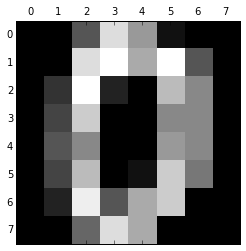

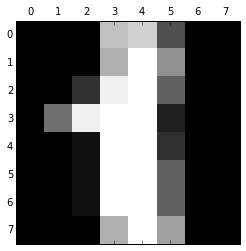

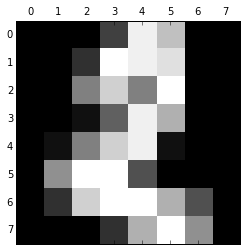

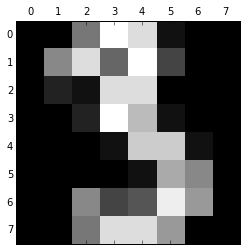

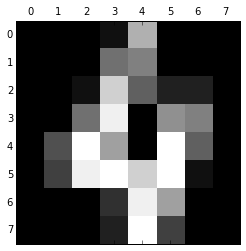

...

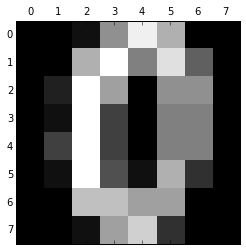

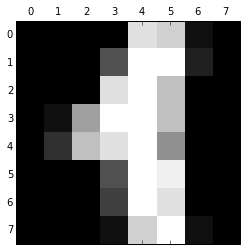

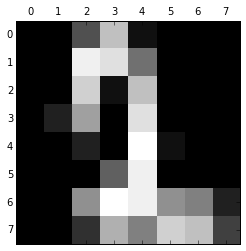

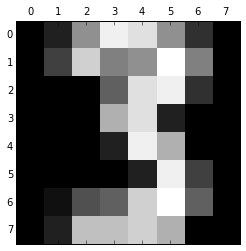

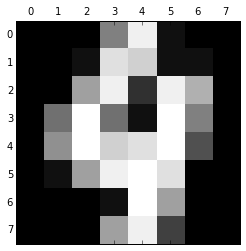

In [29]:
import pylab as pl 
#pl.gray() 
#pl.matshow(digits.images[0]) 
#pl.show() 

i=0
while i < 15:
    pl.matshow(digits.images[i])
    plt.show()
    i=i+1

Automatically created module for IPython interactive environment


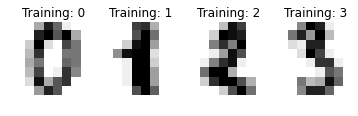

In [30]:
print(__doc__)
import matplotlib.pyplot as plt
from sklearn import datasets, svm, metrics
digits = datasets.load_digits()
images_and_labels = list(zip(digits.images, digits.target))
for index, (image, label) in enumerate(images_and_labels[:4]):
    plt.subplot(2, 4, index + 1)
    plt.axis('off')
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.title('Training: %i' % label)

In [ ]:
# To apply a classifier on this data, we need to flatten the image, to
# turn the data in a (samples, feature) matrix:
n_samples = len(digits.images)
data = digits.images.reshape((n_samples, -1))

2. With x as data and y as target, classify the above datasets into individual targets using a decision tree

In [ ]:
from sklearn.datasets import load_iris
from sklearn.cross_validation import cross_val_score
from sklearn.tree import DecisionTreeClassifierclf = DecisionTreeClassifier()
x=data[:n_samples / 2]
y=data[n_samples / 2:]
clf.fit(x, digits.target[:n_samples / 2])
expected = digits.target[n_samples / 2:]
predicted = clf.predict(y)
print("Classification report for classifier %s:\n%s\n"
      % (clf, metrics.classification_report(expected, predicted)))
print("Confusion matrix:\n%s" % metrics.confusion_matrix(expected, predicted))
images_and_predictions = list(zip(digits.images[n_samples / 2:], predicted))
for index, (image, prediction) in enumerate(images_and_predictions[:4]):
    plt.subplot(2, 4, index + 5)
    plt.axis('off')
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.title('Prediction: %i' % prediction)

plt.show()

3. Perform this classification task with sklearn.svm.SVC. How does the choice of kernel affect the results?

In [ ]:
# Create a classifier: a support vector classifier
# We can assume the classifier is black box that you pass parameters and it outputs the fit 
classifier = svm.SVC(gamma=0.001)

# We learn the digits on the first half of the digits
x=data[:n_samples / 2]
y=data[n_samples / 2:]

classifier.fit(x, digits.target[:n_samples / 2])
# Now predict the value of the digit on the second half:
expected = digits.target[n_samples / 2:]
predicted = classifier.predict(y)

In [ ]:
print("Classification report for classifier %s:\n%s\n"
      % (classifier, metrics.classification_report(expected, predicted)))
print("Confusion matrix:\n%s" % metrics.confusion_matrix(expected, predicted))

In [ ]:
images_and_predictions = list(zip(digits.images[n_samples / 2:], predicted))
for index, (image, prediction) in enumerate(images_and_predictions[:4]):
    plt.subplot(2, 4, index + 5)
    plt.axis('off')
    plt.imshow(image, cmap=plt.cm.gray_r, interpolation='nearest')
    plt.title('Prediction: %i' % prediction)

plt.show()

In [ ]:
classifier.score(y, expected)

In [ ]:
n_samples = len(digits.images)
data = digits.images.reshape((n_samples, -1))
classifier = svm.SVC(gamma=0.001, kernel='linear')
classifier.fit(data[:n_samples / 2], digits.target[:n_samples / 2])
expected = digits.target[n_samples / 2:]
predicted = classifier.predict(data[n_samples / 2:])
classifier.score(y, expected)

In [ ]:
classifier = svm.SVC(gamma=0.001, kernel='poly')
x=data[:n_samples / 2]
y=data[n_samples / 2:]
classifier.fit(x, digits.target[:n_samples / 2])
expected = digits.target[n_samples / 2:]
predicted = classifier.predict(y)
classifier.score(y, expected)

4. Perform this classification task with sklearn.ensemble.RandomForestClassifier. Write in the markdown below the impact each of the parammeter had on the result

        1. max_depth: If you dont assign max depth it will go until all true
        2. max_features:=8
        3. n_estimators:

Try a few sets of parameters for each model and check the F1 score (sklearn.metrics.f1_score) on your results. Output the best F1 score that you achieve. 

In [ ]:
from sklearn.ensemble import RandomForestClassifier
firsthalf=data[:n_samples / 2]
secondhalf=data[n_samples / 2:]
RFclf = RandomForestClassifier(maxdepth=10)
RFclf = RFclf.fit(x, digits.target[:n_samples / 2])
expected = digits.target[n_samples / 2:]
predicted = classifier.predict(y)
sk.metrics.f1_score(y,expected)

**Dimensionality Reduction - PCA**

Principal Component Analysis is a very powerful unsupervised method for dimensionality reduction in data. 

Apply dimensionality reduction technique PCA (Principle Component Analysis) on the prev dataset - load_digits(). 
Use the sklearn inbuilt tool sklearn.decomposition.PCA

Print the shape of the matrix before and after the application of PCA on the dataset. Using variance, analyze the ammount of information thrown away and plot the variance(cumulative) against the number of components  

Try other dimensionality reduction techniques - sklearn.decomposition.RandomizedPCA, sklearn.decomposition.FastICA  as well 
(this extended analysis need not be submitted as part of homework)
**Try 3-4 kernals
#pca fit
#pca transform (use 10) and 64 to eigenvectors
#pca explain to graph

In [ ]:
# Print the shape of the matrix before
data.shape

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
k = 20
pca = PCA(n_components=k)
pca.fit(data)
shape(pca.components_)
cumulative_explained = cumsum(pca.explained_variance_ratio_) 
plot(cumulative_explained);
grid()
print pca.explained_variance_ratio_[:10]
pca.fit_transform(data).shape

In [ ]:
sklearn.decomposition.RandomizedPCA

In [ ]:
sklearn.decomposition.FastICA

# Weather Homework Questions

1) Write a script that will return the google maps url when passed with the latitude and longitudinal values of the place

2) Create a map where the density of points is represented as a density map (topographical map)? from instructor "I would recommend that you plot the maps using basemap and not google maps, but you are welcome to explore google maps option as well."

3) Can you create a map that would represent, using color, the values of a chosen column (Mean, Std, V0,V1 etc.)? What conclusions can you draw from this map?

1) Write a script that will return the google maps url when passed with the latitude and longitudinal values of the place

In [ ]:
import googlemaps
 
def gurl_lat_lng(fLat,fLng):
    sURL= ""
    string = "http://maps.google.com/?q=" + str(fLat) +","+str(fLng)
    print string
    return(sURL)

gurl_lat_lng(32.8807,-117.2359)

Populating the interactive namespace from numpy and matplotlib


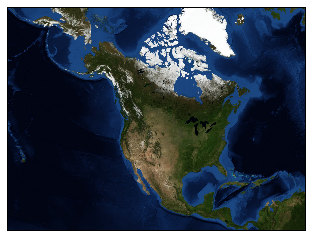

In [11]:
%pylab inline
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
# setup Lambert Conformal basemap.
# set resolution=None to skip processing of boundary datasets.
m = Basemap(width=12000000,height=9000000,projection='lcc',
            resolution=None,lat_1=45.,lat_2=55,lat_0=50,lon_0=-107.)
m.bluemarble()

 
plt.show()

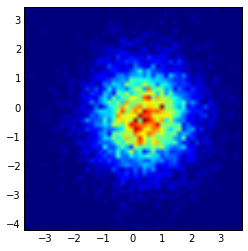

In [9]:
import numpy as np
import numpy.random
import matplotlib.pyplot as plt

# Generate some test data
x = np.random.randn(8873)
y = np.random.randn(8873)

heatmap, xedges, yedges = np.histogram2d(x, y, bins=50)
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]



plt.clf()
plt.imshow(heatmap, extent=extent)
plt.show()

Populating the interactive namespace from numpy and matplotlib


/Users/RyanRiopelle/anaconda/lib/python2.7/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):


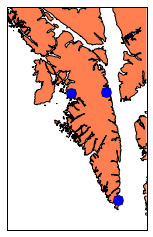

In [6]:
%pylab inline
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import numpy as np
 
my_map = Basemap(projection='merc', lat_0 = 57, lon_0 = -135,
    resolution = 'h', area_thresh = 0.1,
    llcrnrlon=-136.25, llcrnrlat=56.0,
    urcrnrlon=-134.25, urcrnrlat=57.75)
 
my_map.drawcoastlines()
my_map.drawcountries()
my_map.fillcontinents(color = 'coral')
my_map.drawmapboundary()
 
lons = [-135.3318, -134.8331, -134.6572]
lats = [57.0799, 57.0894, 56.2399]
x,y = my_map(lons, lats)
my_map.plot(x, y, 'bo', markersize=10)
 
plt.show()


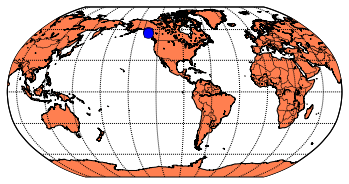

In [8]:
from mpl_toolkits.basemap import Basemap
import matplotlib.pyplot as plt
import numpy as np
 
# make sure the value of resolution is a lowercase L,
#  for 'low', not a numeral 1
my_map = Basemap(projection='robin', lat_0=0, lon_0=-100,
              resolution='l', area_thresh=1000.0)
 
my_map.drawcoastlines()
my_map.drawcountries()
my_map.fillcontinents(color='coral')
my_map.drawmapboundary()
 
my_map.drawmeridians(np.arange(0, 360, 30))
my_map.drawparallels(np.arange(-90, 90, 30))

lons = [-135.3318, -134.8331, -134.6572]
lats = [57.0799, 57.0894, 56.2399]
x,y = my_map(lons, lats)
my_map.plot(x, y, 'bo', markersize=10)

plt.show()

In [12]:
import googlemaps
 
def gurl_lat_lng(fLat,fLng):
    sURL= ""
    string = "http://maps.google.com/?q=" + str(fLat) +","+str(fLng)
    print string
    return(sURL)

gurl_lat_lng(32.8807,-117.2359)

ImportError: No module named googlemaps

Populating the interactive namespace from numpy and matplotlib
/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/weather
85273

`%matplotlib` prevents importing * from pylab and numpy
/Users/RyanRiopelle/anaconda/lib/python2.7/site-packages/matplotlib/collections.py:590: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors == str('face'):



85273 85273 85273


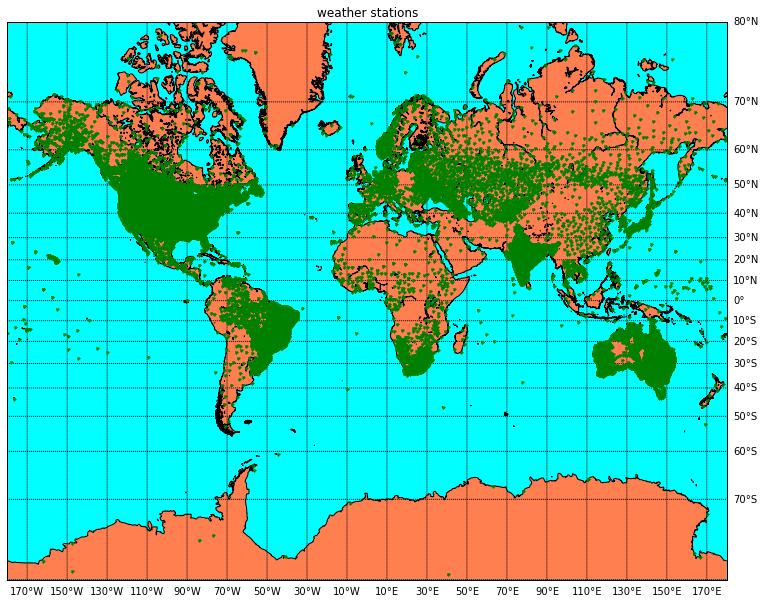

In [45]:
%pylab inline
import pandas as pd
import numpy as np
import sklearn as sk
path_weather = "/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/weather"
%cd $path_weather
#%cd /Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/weather/
#%cs ~/data/weather
#!ls -lh
# Make all lines be of length 90 to solve problem wilth read_fwf
out=open('ghcnd-stations_buffered.txt','w')
for line in open('ghcnd-stations.txt','r').readlines():
    line=line.rstrip()
    string=line+' '*(90-len(line))+'\n'
    out.write(string)
out.close()
colspecs = [(0, 11), (11, 21), (21, 31), (31, 38),(39,41),(41,72),(72,76),(76,80),(80,86)]
stations = pd.read_fwf('ghcnd-stations_buffered.txt', colspecs=colspecs, header=None, index_col=0,
                       names=['latitude','longitude','elevation','state','name','GSNFLAG','HCNFLAG','WMOID'])

stations.head()
lons=stations.ix[:,'longitude'].values
lats=stations.ix[:,'latitude'].values
#temp=stations.ix[:,'Color'].values
station_names=stations.index.values
ll=len(lons)
lonmin=-180;lonmax=180;latsmin=-80;latsmax=80;
select=(lons>lonmin) * (lons<lonmax)*(lats>latsmin)*(lats<latsmax)
print sum(select)
station_names=station_names[select]
lons=lons[select]
lats=lats[select]
print len(lons),len(lats),len(station_names)
from mpl_toolkits.basemap import Basemap
import numpy as np
import matplotlib.pyplot as plt
# llcrnrlat,llcrnrlon,urcrnrlat,urcrnrlon
# are the lat/lon values of the lower left and upper right corners
# of the map.
# lat_ts is the latitude of true scale.
# resolution = 'i' means use intermediate resolution coastlines.
plt.figure(figsize=(15,10),dpi=300)
m = Basemap(projection='merc',llcrnrlat=latsmin,urcrnrlat=latsmax,\
            llcrnrlon=lonmin,urcrnrlon=lonmax,lat_ts=20,resolution='i')
m.drawcoastlines()
m.fillcontinents(color='coral',lake_color='aqua')
# draw parallels and meridians.
parallels = np.arange(-80,81,10.)
# labels = [left,right,top,bottom]
m.drawparallels(parallels,labels=[False,True,True,False])
meridians = np.arange(10.,351.,20.)
m.drawmeridians(meridians,labels=[True,False,False,True])
#m.drawparallels(np.arange(-90.,91.,30.))
#m.drawmeridians(np.arange(-180.,181.,60.))
m.drawmapboundary(fill_color='aqua')
# draw map with markers for locations

x, y = m(lons,lats)
m.plot(x,y,'g.')
plt.title('weather stations')
plt.show()

In [47]:
stations['station'] = stations.index
stations.head()

,latitude,longitude,elevation,state,name,GSNFLAG,HCNFLAG,WMOID,station
ACW00011604,17.1167,-61.7833,10.1,NaN,ST JOHNS COOLIDGE FLD,NaN,NaN,NaN,ACW00011604
ACW00011647,17.1333,-61.7833,19.2,NaN,ST JOHNS,NaN,NaN,NaN,ACW00011647
AE000041196,25.3330,55.5170,34.0,NaN,SHARJAH INTER. AIRP,GSN,NaN,41196,AE000041196
AF000040930,35.3170,69.0170,3366.0,NaN,NORTH-SALANG,GSN,NaN,40930,AF000040930
AG000060390,36.7167,3.2500,24.0,NaN,ALGER-DAR EL BEIDA,GSN,NaN,60390,AG000060390


In [48]:
path_weather = "/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/weather"
%cd $path_weather

header=['station','measurement','year']+range(1,366)
# D=pandas.DataFrame(columns=header)
Data = pd.read_csv('SAMPLE_TMAX.csv',header=None,names=header)
G=Data.ix[:,3:369]
G[G<-400]=np.nan   #remove outliers
G[G>500]=np.nan
G=G/10   # temp / 10 is the temp in celsius
Data.ix[:,3:369]=G
G=G.transpose()
Data.head()


# a simple scale function to normalize the data-frame row-by-row
from numpy import mean, std
def scale_temps(Din):
    matrix=Din.iloc[:,3:]
    Dout=Din.loc[:,['station','year']+range(1,366)]
    Mean=mean(matrix, axis=1).values
    Dout['Mean']=Mean
    Std= std(matrix, axis=1).values
    Dout['Std']=Std
    # Decided not to normalize each year to have mean zero and std 1
    # tmp = pd.DataFrame((matrix.values - Mean[:,np.newaxis])/Std[:,newaxis],columns=range(1,366))
    # print tmp.head()
    Dout.loc[:,3:368]=matrix.values
    return Dout
Dout=scale_temps(Data)
#reorder the columns
Dout1=Dout[['station','year','Mean','Std']]
Dout1= Dout1.drop_duplicates('station')
Dout1.head()

/Users/RyanRiopelle/Documents/DSE/rriopell/DSE200/data/weather


,station,year,Mean,Std
0,USC00507570,2005,6.1,10.439819
1,NOE00135018,1959,6.1,7.974400
2,KZ000036546,1982,-9.9,14.897310
3,USC00054664,1964,-15.0,10.790115
4,CUW00011706,1981,31.1,1.588618


In [72]:
df_xy_temp = pd.merge(stations, Dout1, how='outer', on=['station'])
df_xy= df_xy_temp.dropna()
df_xy.head()

,latitude,longitude,elevation,state,name,GSNFLAG,HCNFLAG,WMOID,station,year,Mean,Std
82945,34.8831,-82.2203,286.5,C,GREER,GSN,HCN,72312,USW00003870,1969,16.7,8.959157
83137,29.5442,-98.4839,240.5,X,SAN ANTONIO INTL AP,GSN,HCN,72253,USW00012921,1973,13.3,6.965640
83406,42.2122,-71.1136,190.5,A,BLUE HILL,GSN,HCN,74492,USW00014753,1981,1.1,10.697228
83421,43.1111,-76.1039,125.9,Y,SYRACUSE HANCOCK INTL AP,GSN,HCN,72519,USW00014771,1972,13.9,11.256139
83517,44.8831,-93.2289,265.8,N,MINNEAPOLIS/ST PAUL AP,GSN,HCN,72658,USW00014922,2004,5.6,12.551815


In [91]:
type(df_xy)
df_xy.loc['color']=0
#[df_xy[df_xy['mean']>10['color'] = 'r.'

/Users/RyanRiopelle/anaconda/lib/python2.7/site-packages/ipykernel/__main__.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  from ipykernel import kernelapp as app


11
11 11 11


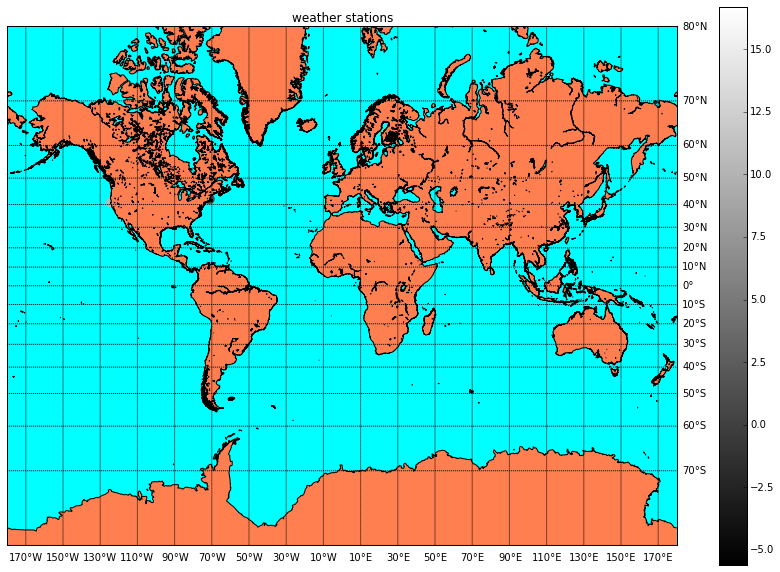

In [79]:
lons=df_xy.ix[:,'longitude'].values
lats=df_xy.ix[:,'latitude'].values
temp=df_xy.ix[:,'Mean'].values
#temp=stations.ix[:,'Color'].values
station_names=df_xy.index.values
ll=len(lons)
lonmin=-180;lonmax=180;latsmin=-80;latsmax=80;
select=(lons>lonmin) * (lons<lonmax)*(lats>latsmin)*(lats<latsmax)
print sum(select)
station_names=station_names[select]
lons=lons[select]
lats=lats[select]
print len(lons),len(lats),len(station_names)
from mpl_toolkits.basemap import Basemap
import numpy as np
import matplotlib.pyplot as plt

plt.figure(figsize=(15,10),dpi=300)
m = Basemap(projection='merc',llcrnrlat=latsmin,urcrnrlat=latsmax,\
            llcrnrlon=lonmin,urcrnrlon=lonmax,lat_ts=20,resolution='i')
m.drawcoastlines()
m.fillcontinents(color='coral',lake_color='aqua')
parallels = np.arange(-80,81,10.)

m.drawparallels(parallels,labels=[False,True,True,False])
meridians = np.arange(10.,351.,20.)
m.drawmeridians(meridians,labels=[True,False,False,True])
m.drawmapboundary(fill_color='aqua')

x, y = m(lons,lats)
m.scatter(x,y,c=temp,s=100, edgecolor='')
plt.colorbar()
plt.title('weather stations')
plt.show()